In [ ]:
from google.colab import files
files.upload()

{}

In [ ]:
# Configure Kaggle API

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d jangedoo/utkface-new

Dataset URL: https://www.kaggle.com/datasets/jangedoo/utkface-new
License(s): copyright-authors
100% 331M/331M [00:18<00:00, 22.0MB/s]
100% 331M/331M [00:18<00:00, 19.1MB/s]


In [ ]:
!unzip utkface-new.zip -d utkface

Görüntülenen çıkış son 5000 satıra kısaltıldı.
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_0_20170109004755204.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_0_20170111182452832.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_1_20170103230340961.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_1_20170104011329697.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_1_20170104165020320.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_1_20170108230211421.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_2_20170104022134829.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_2_20170104023010725.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_2_20170104172537171.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_2_20170104201443273.jpg.chip

In [ ]:
import os
print(os.listdir())

['.config', 'kaggle.json', 'utkface', 'utkface-new.zip', 'sample_data']


In [ ]:
print(os.listdir('utkface'))

['UTKFace', 'crop_part1', 'utkface_aligned_cropped']


In [ ]:
import os
import pandas as pd
import numpy as np
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.utils import resample
import random
import matplotlib.pyplot as plt
import seaborn as sns

from tensorflow.keras.models import Sequential, load_model, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, Input
from tensorflow.keras import optimizers
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, TensorBoard
from tensorflow.keras.applications import VGG16
from tensorflow.keras.optimizers import Adam


In [ ]:
# Use os.path.join for platform-independent file paths
data_dir = 'utkface'
utkface_dir = os.path.join(data_dir, 'UTKFace')
crop_part1_dir = os.path.join(data_dir, 'crop_part1')

In [ ]:
utkface_dir = 'utkface/UTKFace'
crop_part1_dir = 'utkface/crop_part1'

In [ ]:
# Function to select random images from directories and display them to compare visual differences between two datasets
def select_random_images(directory, num_images):
    images = []
    files = os.listdir(directory)
    selected_files = random.sample(files, num_images)
    for file in selected_files:
        img_path = os.path.join(directory, file)
        img = load_img(img_path)
        images.append(img)
    return images

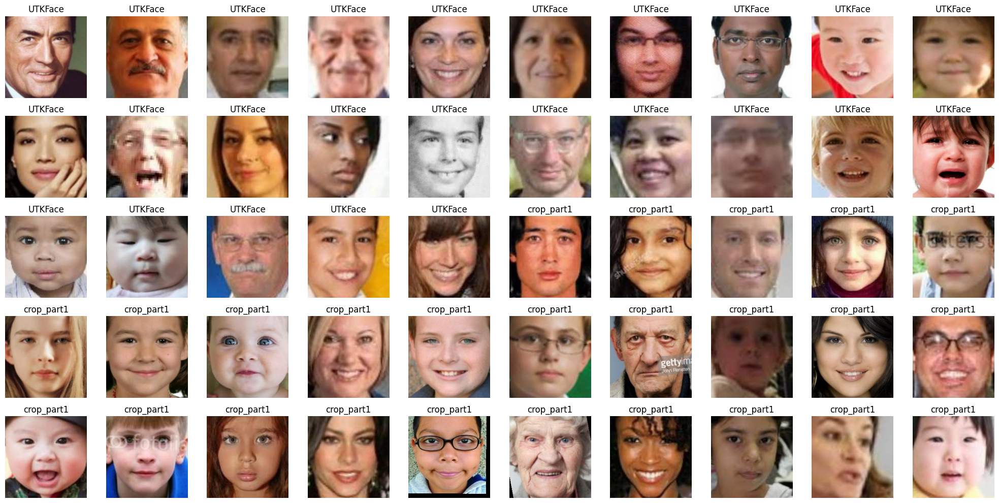

In [ ]:
utkface_images = select_random_images(utkface_dir, 25)
crop_part1_images = select_random_images(crop_part1_dir, 25)

fig, axes = plt.subplots(5, 10, figsize=(20, 10))

for i, ax in enumerate(axes.flatten()):
    if i < 25:
        ax.imshow(utkface_images[i])
        ax.set_title('UTKFace')
    else:
        ax.imshow(crop_part1_images[i - 25])
        ax.set_title('crop_part1')
    ax.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
# Extract age and gender from filenames

In [ ]:
images = []
ages = []
genders = []

In [ ]:
for i in os.listdir(utkface_dir):
    split = i.split('_')
    ages.append(int(split[0]))
    genders.append(int(split[1]))
    images.append(load_img(os.path.join(utkface_dir, i)))

for i in os.listdir(crop_part1_dir):
    split = i.split('_')
    ages.append(int(split[0]))
    genders.append(int(split[1]))
    images.append(load_img(os.path.join(crop_part1_dir, i)))

In [ ]:
images = pd.Series(images, name='Images')
ages = pd.Series(ages, name='Ages')
genders = pd.Series(genders, name='Genders')

df = pd.concat([images, ages, genders], axis=1)

In [ ]:
# Visualize age distribution

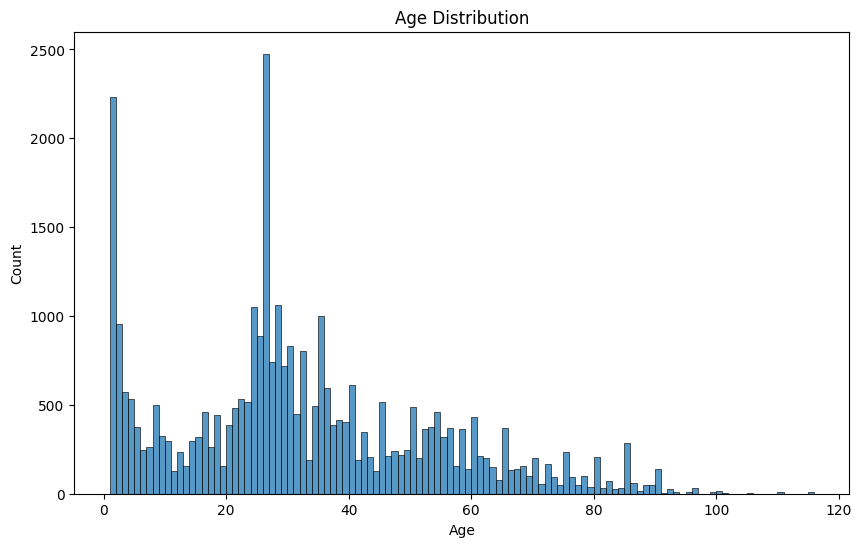

In [ ]:
age_group_counts = df['Ages'].value_counts().sort_index()

plt.figure(figsize=(10, 6))
sns.histplot(df['Ages'], bins=range(df['Ages'].min(), df['Ages'].max() + 1), kde=False)
plt.title('Age Distribution')
plt.xlabel('Age')
plt.ylabel('Count')
plt.show()

In [ ]:
# Group ages into 10-year intervals and visualizing

AgeGroup
(0, 10]      6304
(10, 20]     2840
(20, 30]     9307
(30, 40]     5349
(40, 50]     2795
(50, 60]     3181
(60, 70]     1744
(70, 80]     1082
(80, 90]      756
(90, 100]     106
Name: count, dtype: int64


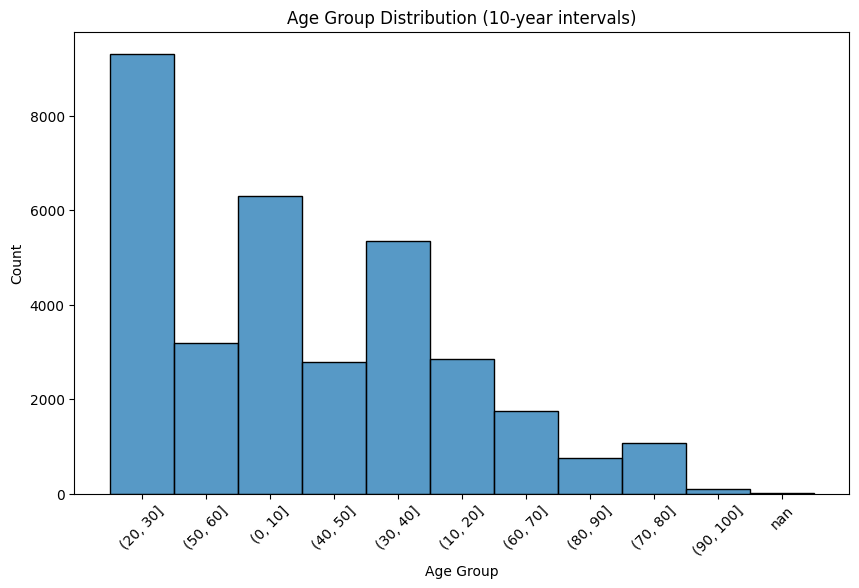

In [ ]:
df['AgeGroup'] = pd.cut(df['Ages'], bins=range(0, 101, 10))
age_group_counts = df['AgeGroup'].value_counts().sort_index()

print(age_group_counts)

plt.figure(figsize=(10, 6))
sns.histplot(df['AgeGroup'].astype(str), kde=False)
plt.title('Age Group Distribution (10-year intervals)')
plt.xlabel('Age Group')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Cap ages at 85 to prevent outliers

df['Ages'] = df['Ages'].apply(lambda x: 85 if x > 85 else x)

In [ ]:
# Balance the dataset by age and sample 15,000 examples

balanced_df = df.groupby('Ages').apply(lambda x: x.sample(min(len(x), 500))).reset_index(drop=True)
final_df = balanced_df.sample(n=15000, random_state=42).reset_index(drop=True)

In [ ]:
# Preprocess images for model input

In [ ]:
X = np.array([img_to_array(img.resize((128, 128))) / 255.0 for img in final_df['Images']])

In [ ]:
y_ages = final_df['Ages'].values

print(f"Total images: {len(X)}")
print(f"Age distribution: {np.bincount(y_ages)}")

Total images: 15000
Age distribution: [  0 302 277 297 281 226 139 154 283 204 169  80 137  92 158 186 267 146
 269  93 230 281 312 294 306 294 301 299 284 315 279 260 304 116 277 288
 286 244 249 250 280 111 187 130  62 281 120 144 126 146 299 112 212 219
 265 185 220 103 203  89 254 122 119  86  48 225  80  73  88  56 113  31
  92  55  30 127  55  27  57  25 120  19  36  17  19 303]


In [ ]:
y_genders = final_df['Genders'].values

print(f"Total people: {len(X)}")
print(f"gender distribution: {np.bincount(y_genders)}")

Total people: 15000
gender distribution: [7639 7361]


In [ ]:
y_age = final_df['Ages']
y_gender = final_df['Genders']

In [ ]:
x_train_age, x_test_age, y_train_age, y_test_age = train_test_split(X, y_age, test_size=0.2, random_state=42)
x_train_gender, x_test_gender, y_train_gender, y_test_gender = train_test_split(X, y_gender, test_size=0.2, random_state=42)

In [ ]:
os.makedirs('models', exist_ok=True)

In [ ]:
early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

model_checkpoint_age= ModelCheckpoint('models/age_model.keras', monitor='val_loss', save_best_only=True)
model_checkpoint_gender = ModelCheckpoint('models/gender_model.keras', monitor='val_loss', save_best_only=True)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.00001)
reduce_lr_ft = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.000001)

tensorboard_age = TensorBoard(log_dir='logs/agemodel')
tensorboard_gender = TensorBoard(log_dir='logs/gendermodel', histogram_freq=1)

In [ ]:
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

x = base_model.output
x = Flatten()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
age_output = Dense(1, activation='linear', name='age_output')(x)

model = Model(inputs=base_model.input, outputs=age_output)

# Freeze base model layers
for layer in base_model.layers:
    layer.trainable = False

model.compile(optimizer=Adam(learning_rate=0.001),
              loss='mse',
              metrics=['mae'])

model.summary()


58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 128, 128, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 128, 128, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 128, 128, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 64, 64, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 64, 64, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 32, 32, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 32, 32, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 32, 32, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 16, 16, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 16, 16, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 16, 16, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 8, 8, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 8, 8, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 8, 8, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 4, 4, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │       4,194,816 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 18,910,017 (72.14 MB)

 Trainable params: 4,195,329 (16.00 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [ ]:
history = model.fit(x_train_age, y_train_age,
                    validation_data=(x_test_age, y_test_age),
                    epochs=300,
                    batch_size=32,
                    callbacks=[early_stopping, model_checkpoint_age, reduce_lr, tensorboard_age])

Epoch 1/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 23s 42ms/step - loss: 298.4490 - mae: 13.2754 - val_loss: 152.7251 - val_mae: 9.5677 - learning_rate: 0.0010
Epoch 2/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - loss: 158.2442 - mae: 9.7072 - val_loss: 132.6939 - val_mae: 8.8906 - learning_rate: 0.0010
Epoch 3/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - loss: 134.9789 - mae: 9.0104 - val_loss: 125.8570 - val_mae: 8.8119 - learning_rate: 0.0010
Epoch 4/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - loss: 126.1481 - mae: 8.6880 - val_loss: 120.6624 - val_mae: 8.4381 - learning_rate: 0.0010
Epoch 5/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - loss: 120.0665 - mae: 8.4815 - val_loss: 113.9950 - val_mae: 8.1911 - learning_rate: 0.0010
Epoch 6/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - loss: 114.4145 - mae: 8.2116 - val_loss: 149.4484 - val_mae: 9.4304 - learning_rate: 0.0010
Epoch 7/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - loss: 112.7689 - mae: 8.1975 - val_loss: 112.818

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


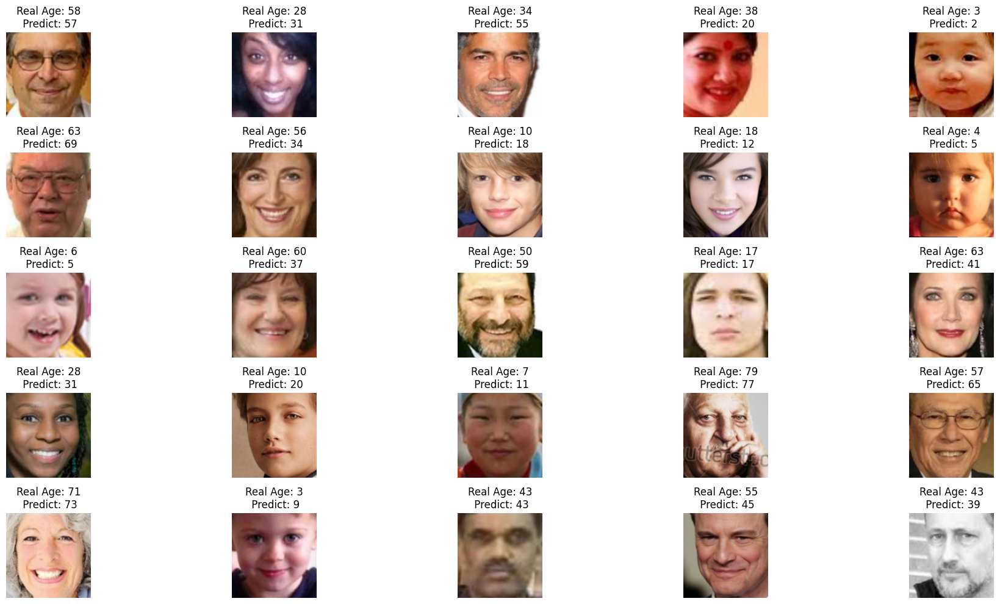

In [ ]:
# Display predictions on test images to compare
fixed_random_state = 42
selected_images = final_df.sample(n=25, random_state=fixed_random_state).reset_index(drop=True)

X_test_images = np.array([img_to_array(img.resize((128, 128))) / 255.0 for img in selected_images['Images']])
y_true_ages = selected_images['Ages'].values

y_pred_ages = model.predict(X_test_images)
y_pred_ages = y_pred_ages.flatten()

plt.figure(figsize=(20, 10))

for i in range(25):
    plt.subplot(5, 5, i + 1)
    plt.imshow(X_test_images[i])
    plt.title(f"Real Age: {y_true_ages[i]}\n Predict: {int(y_pred_ages[i])}")
    plt.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
# Unfreeze and fine-tune base model layers
for layer in base_model.layers[100:]:
    layer.trainable = True

model.compile(optimizer=Adam(learning_rate=0.0001),
              loss='mse',
              metrics=['mae'])

history_fine = model.fit(x_train_age, y_train_age,
                         validation_data=(x_test_age, y_test_age),
                         epochs=300,
                         batch_size=32,
                         callbacks=[early_stopping, model_checkpoint_age, reduce_lr_ft, tensorboard_age])


Epoch 1/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 19s 43ms/step - loss: 37.7164 - mae: 4.5926 - val_loss: 65.5849 - val_mae: 5.9511 - learning_rate: 1.0000e-04
Epoch 2/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - loss: 39.0083 - mae: 4.6551 - val_loss: 65.2988 - val_mae: 5.8468 - learning_rate: 1.0000e-04
Epoch 3/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 14s 36ms/step - loss: 34.6614 - mae: 4.4155 - val_loss: 72.8222 - val_mae: 6.1165 - learning_rate: 1.0000e-04
Epoch 4/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 14s 36ms/step - loss: 32.6663 - mae: 4.2339 - val_loss: 65.9776 - val_mae: 5.7112 - learning_rate: 1.0000e-04
Epoch 5/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 13s 36ms/step - loss: 31.7497 - mae: 4.1329 - val_loss: 66.4058 - val_mae: 5.9217 - learning_rate: 1.0000e-04
Epoch 6/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 13s 36ms/step - loss: 31.3514 - mae: 4.1603 - val_loss: 66.6526 - val_mae: 5.7595 - learning_rate: 1.0000e-04
Epoch 7/300
375/375 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - loss: 29.0230 - mae: 4.0083 - val_los

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


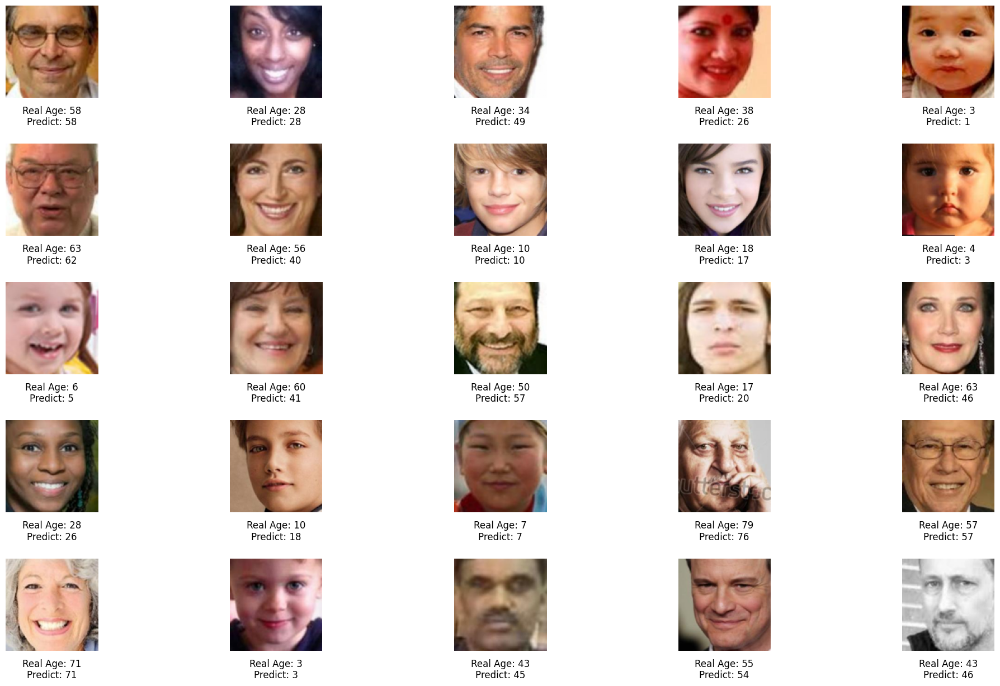

In [ ]:
fixed_random_state = 42

selected_images = final_df.sample(n=25, random_state=fixed_random_state).reset_index(drop=True)

X_test_images = np.array([img_to_array(img.resize((128, 128))) / 255.0 for img in selected_images['Images']])
y_true_ages = selected_images['Ages'].values

y_pred_ages = model.predict(X_test_images)
y_pred_ages = y_pred_ages.flatten()

plt.figure(figsize=(25, 15))

for i in range(25):
    plt.subplot(5, 5, i + 1)
    plt.imshow(X_test_images[i])
    plt.title(f"Real Age: {y_true_ages[i]}\nPredict: {int(y_pred_ages[i])}", y=-0.35)
    plt.axis('off')

plt.subplots_adjust(hspace=0.5)
plt.show()


In [ ]:
train_loss, train_mae = model.evaluate(x_train_age, y_train_age, verbose=0)
test_loss, test_mae = model.evaluate(x_test_age, y_test_age, verbose=0)
print(f"Loss on Training Set: {train_loss}, Loss on Test Set: {test_loss}")
print(f"Mean Absolute Error (MAE) on Training Set: {train_mae}, Mean Absolute Error (MAE) on Test Set: {test_mae}")

Loss on Training Set: 1.0228660106658936, Loss on Test Set: 52.41704177856445
Mean Absolute Error (MAE) on Training Set: 0.678989589214325, Mean Absolute Error (MAE) on Test Set: 4.75259256362915


In [ ]:
# Gender Model

In [ ]:
input_shape = (128, 128, 3)

genmodel = Sequential()
genmodel.add(Input(shape=input_shape))
genmodel.add(Conv2D(32, (3, 3), activation='relu'))
genmodel.add(MaxPooling2D((2, 2)))
genmodel.add(Conv2D(64, (3, 3), activation='relu'))
genmodel.add(MaxPooling2D((2, 2)))
genmodel.add(Conv2D(128, (3, 3), activation='relu'))
genmodel.add(MaxPooling2D((2, 2)))
genmodel.add(Flatten())
genmodel.add(Dense(64, activation='relu'))
genmodel.add(Dropout(0.5))
genmodel.add(Dense(1, activation='sigmoid'))

genmodel.compile(loss='binary_crossentropy',
                 optimizer=optimizers.Adam(learning_rate=0.0001),
                 metrics=['accuracy'])


In [ ]:
history = genmodel.fit(x_train_gender, y_train_gender,
                       epochs=100,
                       batch_size=32,
                       validation_data=(x_test_gender, y_test_gender),
                       callbacks=[early_stopping, model_checkpoint_gender, reduce_lr, tensorboard_gender])

Epoch 1/100
375/375 ━━━━━━━━━━━━━━━━━━━━ 11s 18ms/step - accuracy: 0.6330 - loss: 0.6303 - val_accuracy: 0.8207 - val_loss: 0.4174 - learning_rate: 1.0000e-04
Epoch 2/100
375/375 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - accuracy: 0.8134 - loss: 0.4288 - val_accuracy: 0.8587 - val_loss: 0.3302 - learning_rate: 1.0000e-04
Epoch 3/100
375/375 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - accuracy: 0.8462 - loss: 0.3563 - val_accuracy: 0.8680 - val_loss: 0.3201 - learning_rate: 1.0000e-04
Epoch 4/100
375/375 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - accuracy: 0.8621 - loss: 0.3253 - val_accuracy: 0.8740 - val_loss: 0.2943 - learning_rate: 1.0000e-04
Epoch 5/100
375/375 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - accuracy: 0.8665 - loss: 0.3154 - val_accuracy: 0.8727 - val_loss: 0.2957 - learning_rate: 1.0000e-04
Epoch 6/100
375/375 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - accuracy: 0.8792 - loss: 0.2895 - val_accuracy: 0.8767 - val_loss: 0.2895 - learning_rate: 1.0000e-04
Epoch 7/100
375/375 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/st

In [ ]:
# Load the best gender model and make predictions

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


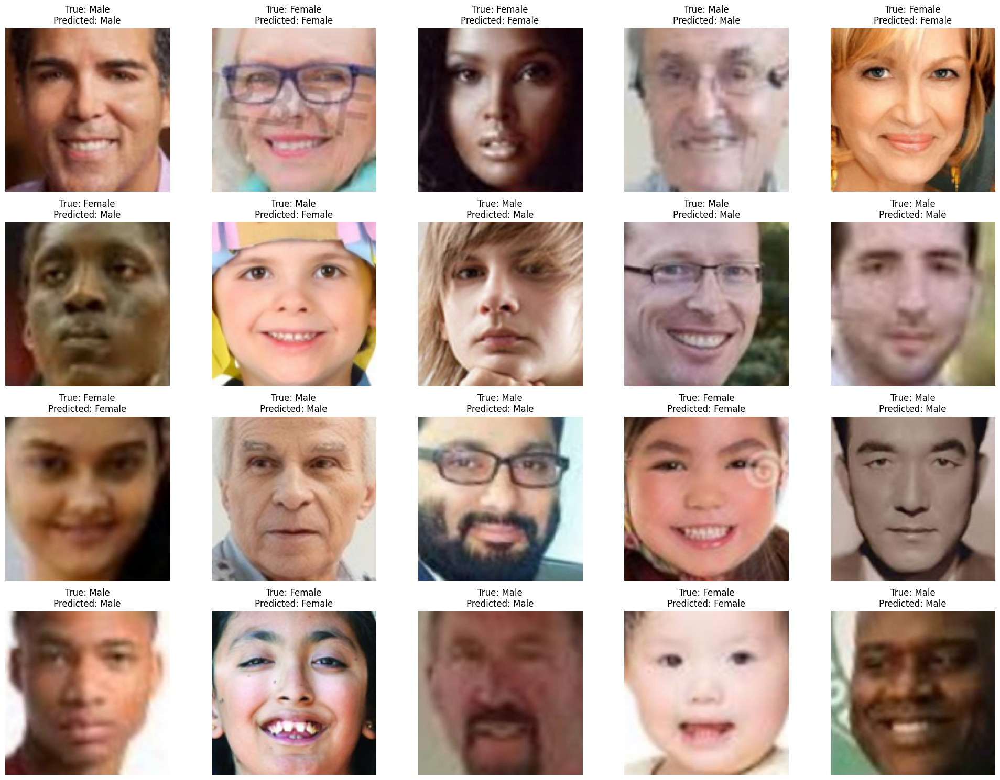

In [ ]:
best_model = load_model('models/gender_model.keras')
num_samples = 20
random_indices = np.random.choice(x_test_gender.shape[0], num_samples, replace=False)
sample_images = x_test_gender[random_indices]
true_genders = y_test_gender.iloc[random_indices].values

predicted_genders = best_model.predict(sample_images).flatten()

plt.figure(figsize=(20, 15))
for i in range(num_samples):
    plt.subplot(4, 5, i+1)
    plt.imshow(sample_images[i])
    true_gender = 'Female' if true_genders[i] == 1 else 'Male'
    predicted_gender = 'Female' if predicted_genders[i] >= 0.5 else 'Male'
    plt.title(f'True: {true_gender}\nPredicted: {predicted_gender}')
    plt.axis('off')
plt.tight_layout()
plt.show()


In [ ]:
train_loss, train_accuracy = genmodel.evaluate(x_train_gender, y_train_gender, verbose=0)
test_loss, test_accuracy = genmodel.evaluate(x_test_gender, y_test_gender, verbose=0)

print(f"Loss on Training Set: {train_loss}, Loss on Test Set: {test_loss}")
print(f"Accuracy on Training Set: {train_accuracy}, Accuracy on Test Set: {test_accuracy}")

Loss on Training Set: 0.12089388072490692, Loss on Test Set: 0.22400663793087006
Accuracy on Training Set: 0.9572499990463257, Accuracy on Test Set: 0.9070000052452087


In [ ]:
# Launch TensorBoard to visualize training

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir logs/agemodel

<IPython.core.display.Javascript object>

In [ ]:
%tensorboard --logdir logs/gendermodel

<IPython.core.display.Javascript object>